In [1]:
%load_ext autoreload
%autoreload 2
import plotly.offline as pyo
import plotly.graph_objects as go

import numpy as np
import scipy as sp
import torch as th

import os
import pdb
import sys
import json
import glob
import tqdm
import pandas as pd

import matplotlib.pyplot as plt
import seaborn as sns
sns.set(context='poster',
        style='ticks',
        font_scale=1,
        rc={'axes.grid':True,
            'grid.color':'.9',
            'grid.linewidth':0.75})
from itertools import product

plt.rcParams['figure.figsize'] = [10, 10]
plt.rcParams['figure.dpi'] = 200


dev = 'cuda'

pyo.init_notebook_mode()
import plotly.express as px
import sys
sys.path.insert(0, '/home/ubuntu/ext_vol/inpca')
from utils import get_data, get_idx, load_d
from reparameterization import project

In [2]:
data = get_data()
labels = {}
qs = {}
ps = {}
for key in ['train', 'val']:
    k = 'yh' if key == 'train' else 'yvh'
    y_ = np.array(data[key].targets, dtype=np.int32)
    y = np.zeros((y_.size, y_.max()+1))
    y[np.arange(y_.size), y_] = 1
    qs[k] = np.sqrt(np.expand_dims(y, axis=0))
    ps[k] = np.sqrt(np.ones_like(qs[k]) / 10)
    labels[k] = y_

In [3]:
df = th.load('/home/ubuntu/ext_vol/inpca/results/models/loaded/didx_all.p').reset_index(drop=True)

## $\lambda$ vs err/loss

In [62]:
indices = df.groupby(['seed', 'aug', 'm', 'opt', 'bs', 'lr', 'wd']).indices
trained = []
for (c, idx) in indices.items():
    if df.iloc[idx]['err'].iloc[-1] <= 0.1:
        trained.extend(idx)

In [63]:
df_ = df.iloc[trained]

In [ ]:
fig = px.scatter(df_, x='lam_yh', y='verr', color='opt', symbol='m')
fig.update_traces(marker=dict(size=3))

In [ ]:
indices = df_.groupby(['seed', 'aug', 'm', 'opt', 'bs', 'lr', 'wd']).indices
for (c, idx) in list(indices.items())[:100]:
    fig = px.line(df_.iloc[idx], x='t',
                    y='lam_yh', color='m', symbol='opt')
    fig.update_traces(marker=dict(size=3))

In [ ]:
fig = px.scatter(df_, x='err', y='lam_yh', color='opt', symbol='m')
fig.update_traces(marker=dict(size=3))

In [ ]:
fig = px.scatter(df_[df_['favg'] < 10], x='favg', y='lam_yh', color='m', symbol='bs')
fig.update_traces(marker=dict(size=3))

In [90]:
didx = th.load('/home/ubuntu/ext_vol/inpca/inpca_results_avg_new/didx_yh_all.p')

In [104]:
didx = didx[didx['seed'] > 0].reset_index(drop=True)

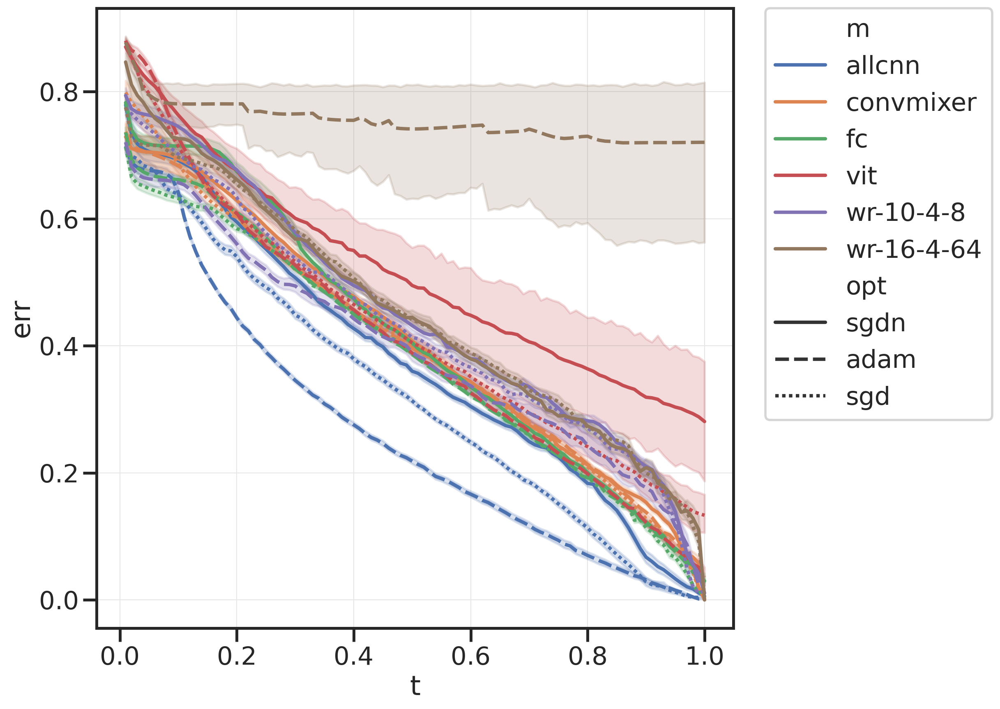

In [108]:
fig = sns.lineplot(data=didx, x='t', y='err', hue='m', style='opt')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)

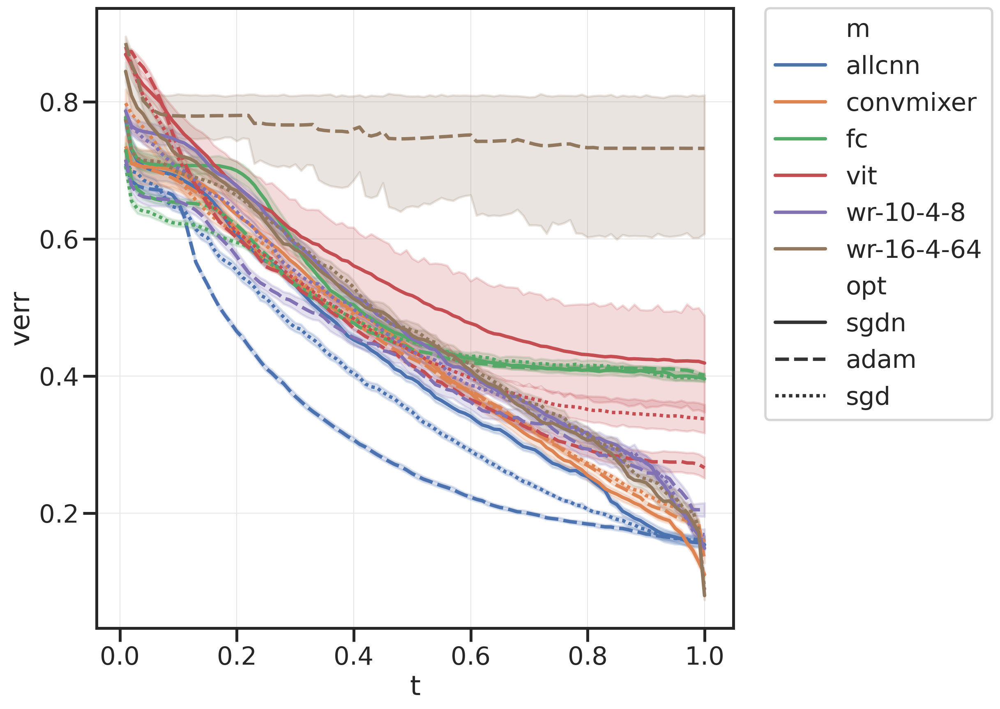

In [109]:
fig = sns.lineplot(data=didx, x='t', y='verr', hue='m', style='opt')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)

## Sample-wise $\lambda$

In [5]:
def sample_lam(f, N=10, loc='/home/ubuntu/results/inpca/results/models/loaded/', name=''):
    
    d = th.load(os.path.join(loc, f))
    key = 'yh'
    yhs = np.sqrt(np.exp(np.stack(d[key].values)))

    r = yhs
    p = np.repeat(ps[key], yhs.shape[0], axis=0)
    q = np.repeat(qs[key], yhs.shape[0], axis=0)
    lams=project(r, p, q, mode='mean')

    df = pd.DataFrame(lams.squeeze().T)
    df_ = df[df.columns[1:-1:5]]
    df_ = df_.assign(labels = labels[key])
    df_ = df_.assign(name= name)
    df_ = pd.melt(df_, id_vars=['labels', 'name'], var_name='t')

    return df_

In [8]:
df = sample_lam(
'{"seed":46,"bseed":-1,"aug":"simple","m":"convmixer","bn":true,"drop":0.0,"opt":"adam",'+
    '"bs":1000,"lr":0.005,"wd":1e-05,"corner":"normal"}.p',
)
f=sns.displot(data=df, x="value", hue="labels", col="t", kind='kde', col_wrap=3, height=10, aspect=1,
            palette='Set1',
           facet_kws={'sharey': False, 'sharex': True})

/home/ubuntu/anaconda3/envs/pytorch_p38/lib/python3.8/site-packages/seaborn/distributions.py:316: UserWarning:

Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.

/home/ubuntu/anaconda3/envs/pytorch_p38/lib/python3.8/site-packages/seaborn/distributions.py:316: UserWarning:

Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.

/home/ubuntu/anaconda3/envs/pytorch_p38/lib/python3.8/site-packages/seaborn/distributions.py:316: UserWarning:

Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.

/home/ubuntu/anaconda3/envs/pytorch_p38/lib/python3.8/site-packages/seaborn/distributions.py:316: UserWarning:

Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.

/home/ubuntu/anaconda3/envs/pytorch_p38/lib/python3.8/site-packages/seaborn/distributions.py:316: UserWarning:

Dataset has 0 variance; 

/home/ubuntu/anaconda3/envs/pytorch_p38/lib/python3.8/site-packages/seaborn/distributions.py:316: UserWarning:

Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.

/home/ubuntu/anaconda3/envs/pytorch_p38/lib/python3.8/site-packages/seaborn/distributions.py:316: UserWarning:

Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.

/home/ubuntu/anaconda3/envs/pytorch_p38/lib/python3.8/site-packages/seaborn/distributions.py:316: UserWarning:

Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.

/home/ubuntu/anaconda3/envs/pytorch_p38/lib/python3.8/site-packages/seaborn/distributions.py:316: UserWarning:

Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.



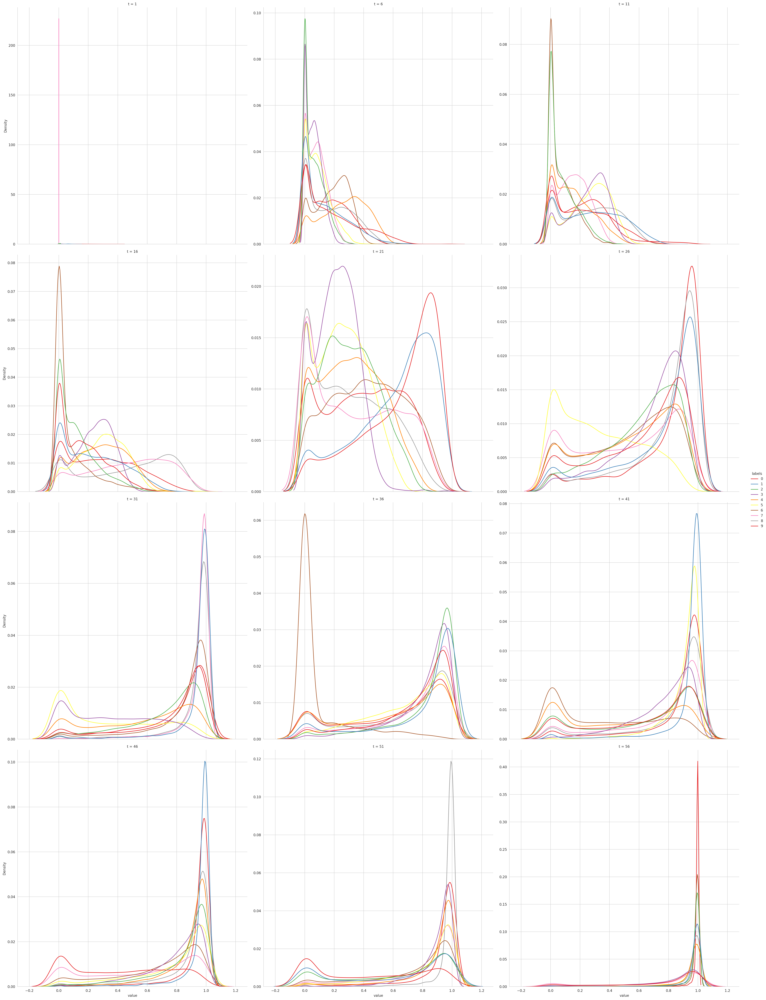

In [10]:
df = sample_lam(
'{"seed":46,"bseed":-1,"aug":"simple","m":"wr-16-4-64","bn":true,"drop":0.0,"opt":"sgdn",'+
    '"bs":500,"lr":0.25,"wd":0.001,"corner":"normal"}.p',
)
f=sns.displot(data=df, x="value", hue="labels", col="t", kind='kde', col_wrap=3, height=10, aspect=1,
            palette='Set1',
           facet_kws={'sharey': False, 'sharex': True})

In [150]:
df = sample_lam(
'{"seed":43,"bseed":-1,"aug":"simple","m":"allcnn","bn":true,"drop":0.0,"opt":"sgd","bs":200,"lr":0.1,"wd":0.0,"corner":"normal"}.p',
)
f=sns.displot(data=df, x="value", hue="labels", col="t", kind='kde', col_wrap=3, height=10, aspect=1,
            palette='Set1',
           facet_kws={'sharey': False, 'sharex': True})

/home/ubuntu/anaconda3/envs/pytorch_p38/lib/python3.8/site-packages/seaborn/distributions.py:316: UserWarning:

Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.

/home/ubuntu/anaconda3/envs/pytorch_p38/lib/python3.8/site-packages/seaborn/distributions.py:316: UserWarning:

Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.

/home/ubuntu/anaconda3/envs/pytorch_p38/lib/python3.8/site-packages/seaborn/distributions.py:316: UserWarning:

Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.



In [141]:
models = [
    '{"seed":42,"bseed":-1,"aug":"simple","m":"fc","bn":true,"drop":0.0,"opt":"sgdn","bs":200,"lr":0.1,"wd":0.0,"corner":"normal"}',
    '{"seed":42,"bseed":-1,"aug":"simple","m":"allcnn","bn":true,"drop":0.0,"opt":"sgdn","bs":200,"lr":0.1,"wd":0.0,"corner":"normal"}',
    '{"seed":42,"bseed":-1,"aug":"simple","m":"convmixer","bn":true,"drop":0.0,"opt":"sgdn","bs":200,"lr":0.1,"wd":0.0,"corner":"normal"}',
]
data = None
for m in models:
    data = pd.concat([data, sample_lam(f"{m}.p", name=json.loads(m)['m'])])

In [142]:
data = data.reset_index()

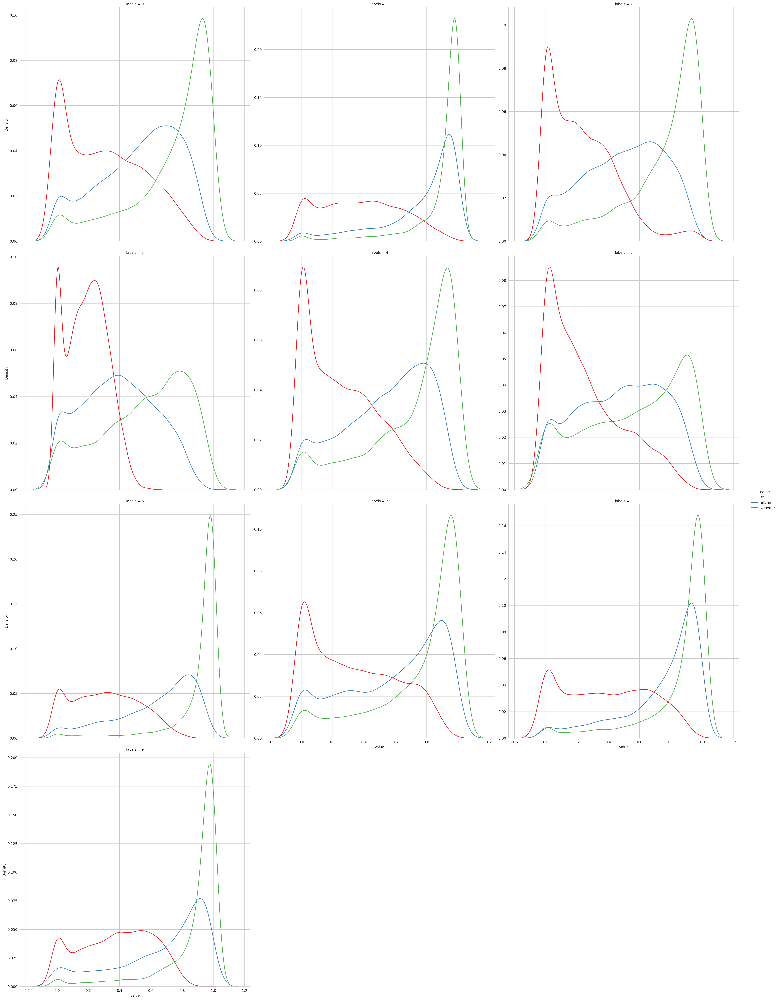

In [148]:
sns.displot(data=data[data['t']==21], x="value", hue="name", col="labels", kind='kde', col_wrap=3, height=10, aspect=1,
            palette='Set1',
           facet_kws={'sharey': False, 'sharex': True})

## $\lambda$ vs t

In [4]:
loc = '/home/ubuntu/ext_vol/inpca/results/models/reindexed_new'
all_files = glob.glob(os.path.join(loc, '*.p'))
file_list = []
for f in all_files:
    configs = json.loads(f[f.find('{'):f.find('}')+1])
    if configs['seed'] > 0:
        file_list.append(f)

In [62]:
didx = th.load("/home/ubuntu/ext_vol/inpca/results/models/loaded/didx_all.p").reset_index(drop=True)
idxs = []
for (config, ii) in didx.groupby(['seed', 'm', 'opt', 'bs', 'aug', 'lr', 'wd']).indices.items():
    tmax = didx.iloc[ii]['t'].max()
    didx.loc[ii, 'nepochs'] = didx.loc[ii, 't'] * didx.loc[ii, 'bs'] / 50000
    if didx.iloc[ii[-1]]['err'] < 0.1:
        idxs.extend(ii)
didx = didx.iloc[idxs].reset_index(drop=True)

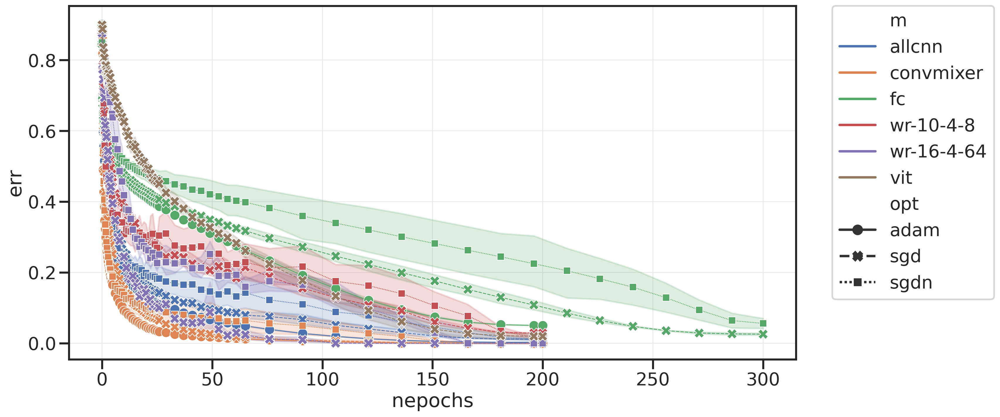

In [12]:
plt.figure(figsize=(16,8))
sns.lineplot(data=didx, x='nepochs', y='err', hue='m', style='opt', markers=True, lw=1)
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)

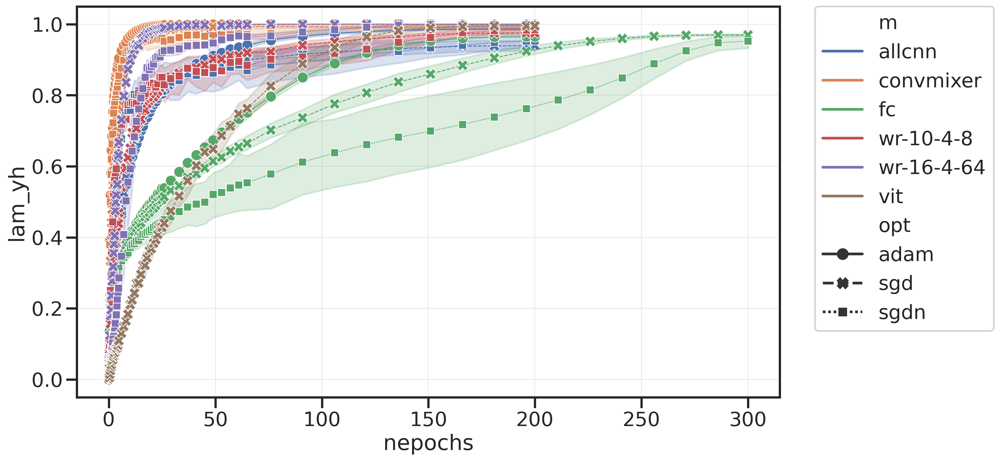

In [18]:
plt.figure(figsize=(14,8))
sns.lineplot(data=didx, x='nepochs', y='lam_yh', hue='m', style='opt', markers=True, lw=1)
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)

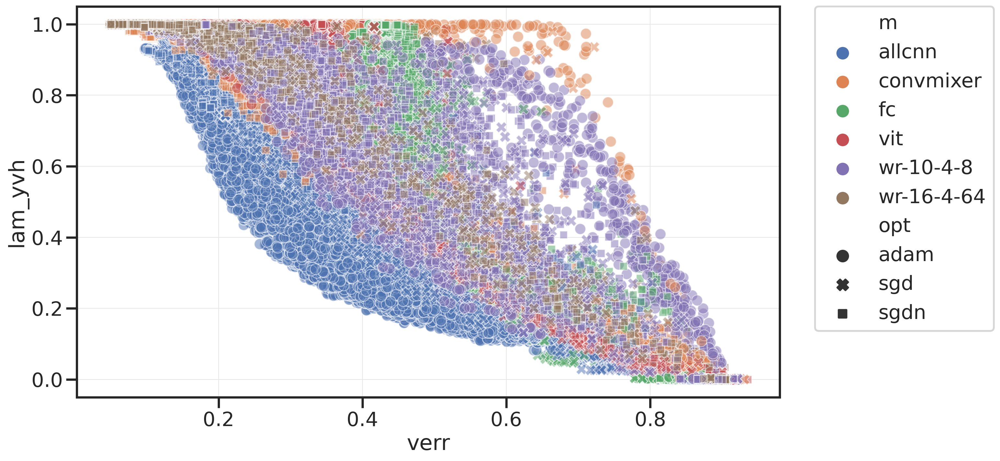

In [63]:
plt.figure(figsize=(14,8))
sns.scatterplot(data=didx, x='verr', y='lam_yvh', hue='m', style='opt', markers=True, alpha=0.5)
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)

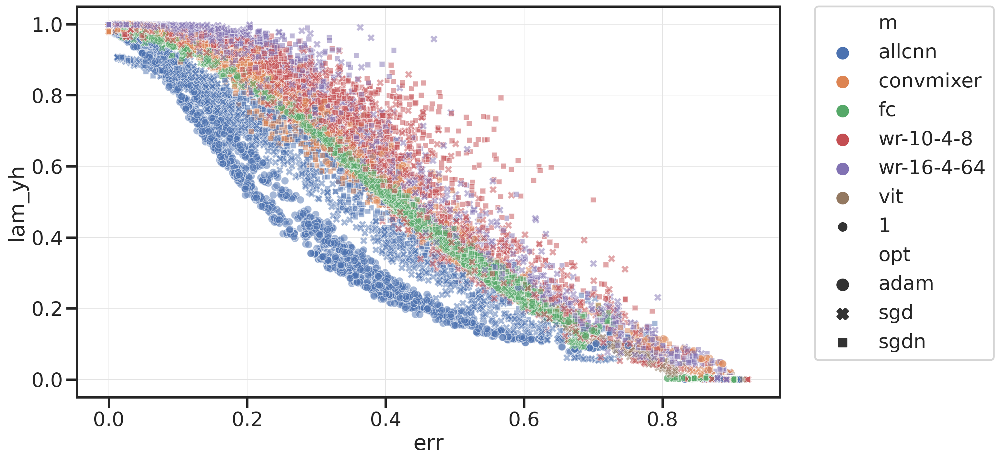

In [21]:
plt.figure(figsize=(14,8))
sns.scatterplot(data=didx, x='err', y='lam_yh', hue='m', style='opt', markers=True, size=1, alpha=0.5)
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)

In [4]:
key = 'yh'
qs_ = np.repeat(qs[key], 100, axis=0)
ps_ = np.repeat(ps[key], 100, axis=0)
ts = np.linspace(0, 1, (100+1))[1:]

In [ ]:
df = []
for i in range(10):
    d = load_d(file_list[i:i+1], loaded=True, verbose=False, numpy=False, probs=False)
    yhs = np.sqrt(np.stack(d[key].values))
    lams = project(yhs, ps_, qs_)
    for l in range(len(lams)):
        df.append({
            't':ts[l],
            'lam':lams[l],
            'i':i
        })
df = pd.DataFrame(df)

<AxesSubplot:xlabel='t', ylabel='lam'>

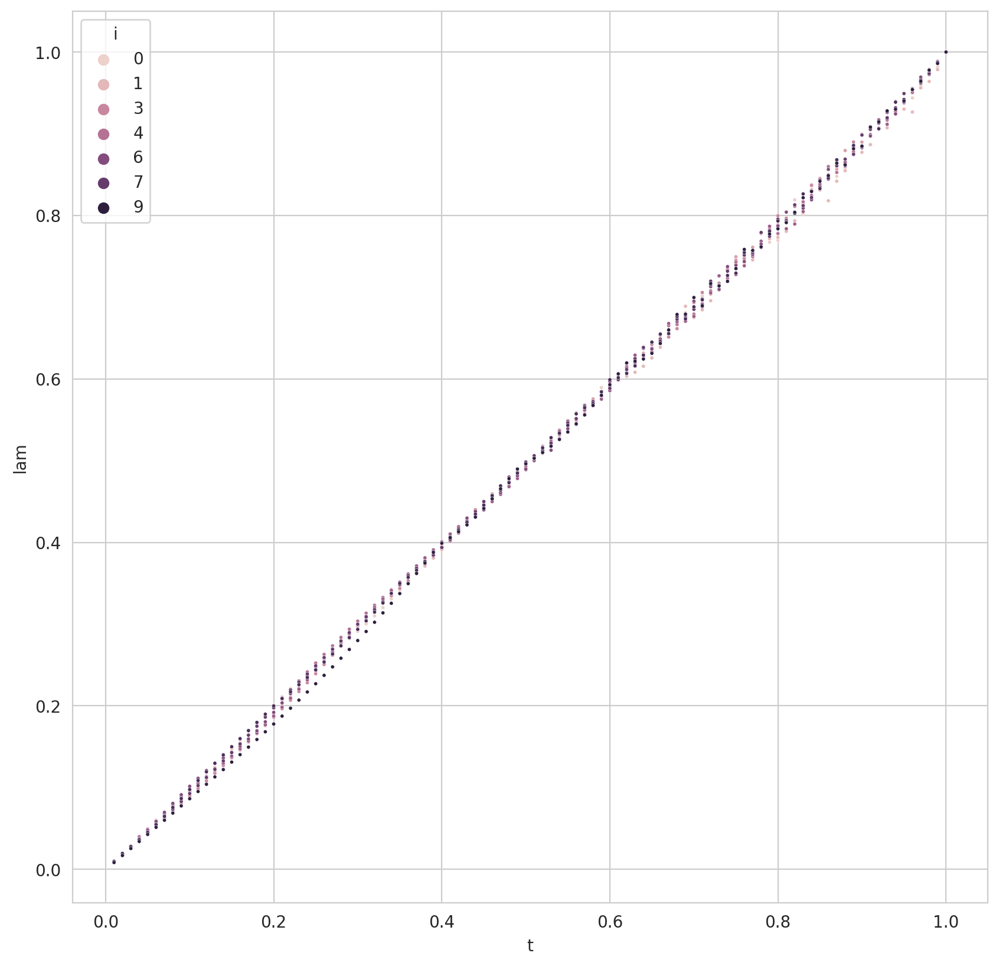

In [11]:
sns.scatterplot(data=df, x='t', y='lam', hue='i', s=5)

## interpolated models vs checkpoints

In [6]:
from collections import defaultdict
from utils import distance

In [14]:
checkpoints_loc = '/home/ubuntu/ext_vol/inpca/results/models/loaded'
interp_loc = '/home/ubuntu/ext_vol/inpca/results/models/reindexed_new'

In [15]:
file_list = defaultdict(list)
for loc in [checkpoints_loc, interp_loc]:
    all_files = glob.glob(os.path.join(loc, '*}.p'))
    for f in all_files:
        configs = json.loads(f[f.find('{'):f.find('}')+1])
        if 'wr' in configs['m'] and 'sgd' in configs['opt'] and configs['bs'] == 200 and configs['aug'] == 'simple':
            file_list[loc].append(f)

In [17]:
didx = None
x = []
idx = ['seed', 'm', 'opt', 't', 'err', 'verr', 'bs', 'aug', 'lr', 'wd', 'interp']
for aa in tqdm.tqdm(range(0, len(file_list[checkpoints_loc]),10)):
    d1 = load_d(file_list=file_list[checkpoints_loc][aa:aa+10], avg_err=False, probs=True, numpy=False, return_nan=False, loaded=True)
    d1['interp'] = False
    didx = pd.concat([didx, d1[idx]])
#     n = len(d1)
#     x.append(th.Tensor(np.stack([d1.iloc[i][key][::2] for i in range(n)])).cpu())

  0%|                                                                                                                                                       | 0/7 [00:11<?, ?it/s]


KeyboardInterrupt: 

In [ ]:
for aa in tqdm.tqdm(range(0, len(file_list[interp_loc]),10)):
    d1 = load_d(file_list=file_list[interp_loc][aa:aa+10], avg_err=False, probs=False, numpy=False, return_nan=False, loaded=True)
    d1['interp'] = True
    d1 = d1.rename(columns={"train_err":"err", "val_err":"verr"})
    didx = pd.concat([didx, d1[idx]])
#     n = len(d1)
#     x.append(th.Tensor(np.stack([d1.iloc[i][key][::2] for i in range(n)])).cpu())

In [ ]:
x = th.vstack(x)

In [ ]:
x.shape

In [ ]:
didx = didx.reset_index()

In [ ]:
w = distance.dbhat(x, x, reduction='mean', dev='cuda', chunks=9000)

In [ ]:
from embed import proj_
l = np.eye(w.shape[0]) - 1.0/w.shape[0]
w = -l @ w @ l / 2
r = proj_(w, len(w), 2)

In [ ]:
dc = didx.drop("index", axis=1)
for (config, idxs) in dc.groupby(['m', 'opt', 'bs', 'aug', 'lr', 'wd', 'interp']).indices.items():
    tmax = dc.iloc[idxs]['t'].max()
    dc.loc[idxs, 't'] /= tmax
for i in range(7):
    dc[f"x{i+1}"] = r['xp'][:, i]
for col in ['seed', 'm', 'opt', 'err',  'verr', 'bs', 'aug', 'lr', 'wd', 'interp']:
    dc[col] = f'{col}: ' + dc[col].astype(str)
text = dc[['seed', 'm', 'opt', 'err',  'verr', 'bs', 'aug', 'lr', 'wd', 'interp']].apply("<br>".join, axis=1)
text = 't: ' + dc['t'].astype(str) + '<br>' + text

In [ ]:
groups = ['seed', 'm', 'opt', 'bs', 'aug', 'lr', 'wd', 'interp']
fig = go.Figure()
for (i, (c, ii)) in enumerate(list(dc.groupby(groups).indices.items())[6:20]):
    dc_ = dc.iloc[ii].reset_index()
    if float(dc_.iloc[-1]['err'][4:]) > 0.1:
        print('skip')
        continue
    lc = 'darkblue' if didx.iloc[ii].interp.values[0] else 'darkred'
#     mode = 'lines' if didx.iloc[ii].interp.values[0] else 'markers'
    fig.add_trace(
        go.Scatter3d(
        x=dc_.x1,  
        y=dc_.x2,  
        z=dc_.x3,  
        hovertemplate='<b>%{text}</b><extra></extra>',
        text=text[ii],
        marker=dict(
            size=2,
            opacity=0.8,
            color=dc_.t,
            symbolsrc='m',
            colorscale='Viridis',
        ),
        line=dict(
            color=lc,
            width=2,
#             opacity=i/79,
        )
    )
    )
    
fig.update_layout(
    autosize=False,
    width=1000,
    height=1000,)

fig.show()
print(r['e'])

In [ ]:
len(list(dc.groupby(groups).indices.items()))

In [ ]:
fig = go.Figure()
groups = ['seed', 'm', 'opt', 'bs', 'aug', 'lr', 'wd', 'interp']
for (i, (c, ii)) in enumerate(list(dc.groupby(groups).indices.items())[::10]):
    dc_ = dc.iloc[ii].reset_index()
    if float(dc_.iloc[-1]['err'][4:]) > 0.1:
        print('skip')
        continue
    if not didx.iloc[ii].interp.values[0]:
        continue
    lc = 'darkblue' if  didx.iloc[ii].seed.values[0] < 0 else 'darkred'
    fig.add_trace(go.Splom(
                dimensions=[dict(label=f'x{i}',
                                 values=dc_[f'x{i}']) for i in range(1, 5)],
                showupperhalf=False, # remove plots on diagonal
                diagonal_visible=False,
                text=text[ii],
                marker=dict(color=lc,
                            showscale=False, # colors encode categorical variables
                        size=2, opacity=0.8),
                ),
                 
            )

# fig = go.Figure(data=)


fig.update_layout(
    autosize=False,
    width=1000,
    height=1000,
)

fig.show()